In [26]:
import numpy as np
import pandas as pd
import lightgbm as lgb
from pathlib import Path
import plotly.express as px
import plotly.graph_objects as go

In [10]:
from sklearn.model_selection import train_test_split

# 環境設定

In [2]:
DATA_PATH = "../data"
RESULT_PATH = "../results"

# 分析

## 前処理

In [7]:
train = pd.read_parquet(Path(DATA_PATH, "train.parquet"))
test = pd.read_parquet(Path(DATA_PATH, "test.parquet"))

In [8]:
train['group'] = train['id'] // 10000
test['group'] = 66

In [9]:
# 説明変数として用いるカラムの一覧
x_columns = train.columns.drop(['id', 'target']).to_list()

In [11]:
train, valid = train_test_split(train, test_size=0.2)

## 学習

In [12]:
models = []
for seed in range(10):
    train_sample = train.sample(frac=0.8, random_state=seed)
    model = lgb.train(
        params={
            'objective': 'regression',
            'learning_rate': 0.05,
            'verbose': 1
        },
        num_boost_round=200,
        train_set=lgb.Dataset(data=train_sample[x_columns], label=train_sample['target'])
    )
    models.append(model)

[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.187485 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4234
[LightGBM] [Info] Number of data points in the train set: 422400, number of used features: 696
[LightGBM] [Info] Start training from score 0.000509
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.223438 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4234
[LightGBM] [Info] Number of data points in the train set: 422400, number of used features: 696
[LightGBM] [Info] Start training from score 0.000047
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.184892 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory

## 予測

In [23]:
valid_y_pred = np.mean([model.predict(valid[x_columns]) for model in models], axis=0)

## 結果確認

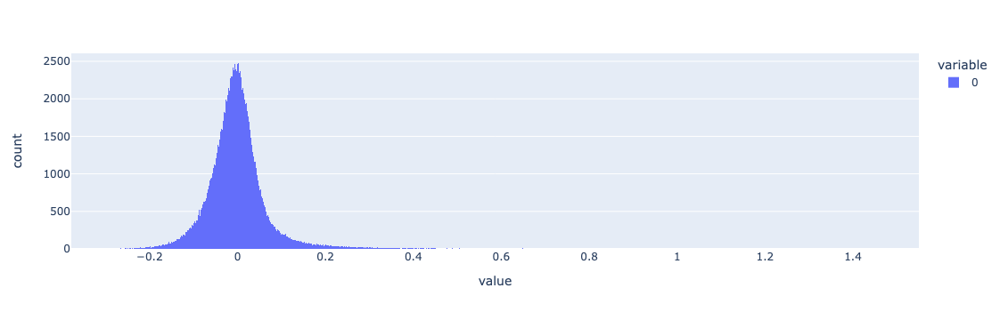

In [58]:
px.histogram(valid_y_pred)

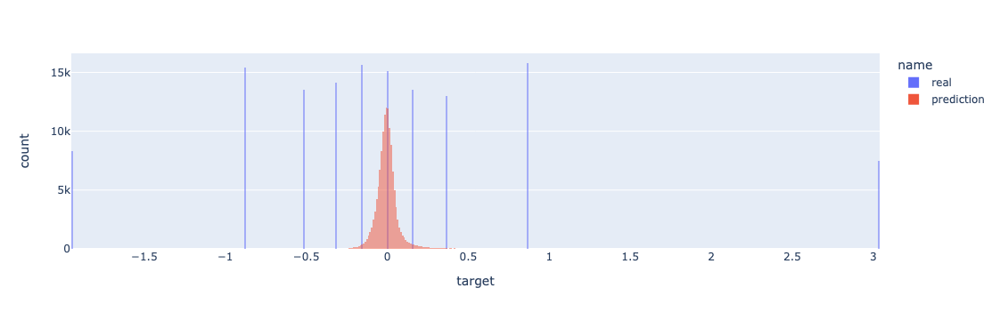

In [59]:
df_1 = pd.DataFrame({"target": valid["target"].values, "name": "real"})
df_2 = pd.DataFrame({"target": valid_y_pred, "name": "prediction"})
df_for_hist = pd.concat([df_1, df_2])
px.histogram(df_for_hist, x="target", color="name", barmode="overlay")

In [60]:
df_2[df_2["target"]>0.3].shape

(1092, 2)

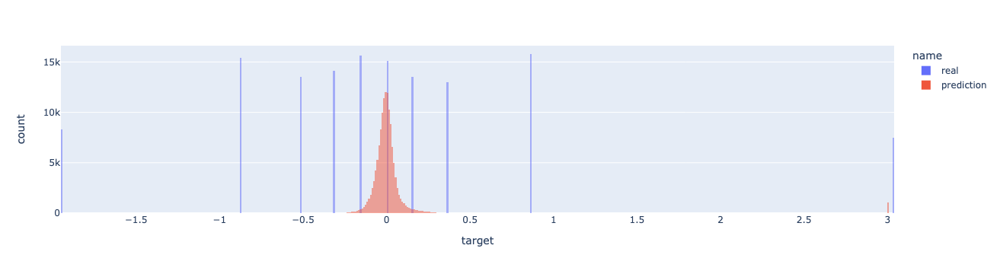

In [44]:
df_2["target"] = df_2["target"].mask(df_2["target"] > 0.3, 3)
df_for_hist = pd.concat([df_1, df_2])
px.histogram(df_for_hist, x="target", color="name", barmode="overlay")

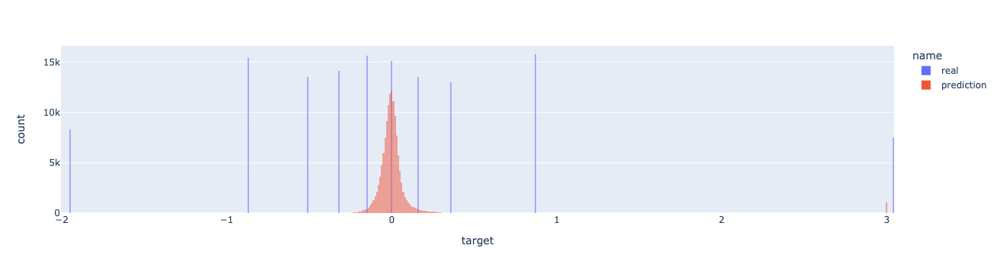

In [45]:
df_2["target"] = df_2["target"].mask(df_2["target"] < -0.3, -2)
df_for_hist = pd.concat([df_1, df_2])
px.histogram(df_for_hist, x="target", color="name", barmode="overlay")

In [28]:
valid["predict"] = valid_y_pred
valid = valid.reset_index(drop=True)

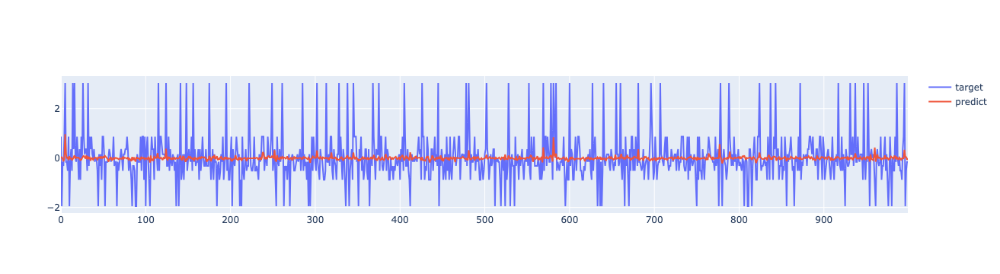

In [32]:
valid_for_plot = valid[0: 1000].copy()
fig = go.Figure(data=[
    go.Scatter(y=valid_for_plot["target"], name="target"),
    go.Scatter(y=valid_for_plot["predict"], name="predict"),
])
fig.show()

In [ ]:
valid_for_plot[valid]

## 後処理

In [51]:
submission = pd.read_csv(Path(RESULT_PATH, '20230903_submission.csv'))

In [54]:
print(submission.shape)
submission.head()

(261661, 2)


,id,target
0,660000,0.072055
1,660001,-0.004226
2,660002,-0.003224
3,660003,-0.047203
4,660004,-0.002087


In [53]:
submission[submission["target"]<-0.1]

,id,target
267,660267,-0.105368
332,660332,-0.107590
438,660438,-0.103172
470,660470,-0.110862
543,660543,-0.108844
...,...,...
261425,921425,-0.140541
261542,921542,-0.115316
261565,921565,-0.116581
261613,921613,-0.130843


In [55]:
submission["target"] = submission["target"].mask(submission["target"] < -0.1, -2)
submission.head()

,id,target
0,660000,0.072055
1,660001,-0.004226
2,660002,-0.003224
3,660003,-0.047203
4,660004,-0.002087


## 提出用ファイルの作成

In [57]:
submission.to_csv(Path(RESULT_PATH, '20230903_submission_ver2.csv'), index=False, header=True)